In [1]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import random
import numpy as np
from matplotlib import cm, colors

In [2]:
# Load the dataset (already done, but repeated for context)
file_path = '/Users/jorge/Desktop/PhD/Code/ExtractFoodWebs/foodwebs_csv/L1P1.csv'
data = pd.read_csv(file_path)

In [3]:
# Filter relevant columns for the graph
edges = data[['con.taxonomy', 'res.taxonomy']].dropna()

# Create a directed graph from the edge list
G = nx.from_pandas_edgelist(edges, source='con.taxonomy', target='res.taxonomy', create_using=nx.DiGraph())

In [13]:
# Generate a layout to avoid node overlap
pos = nx.spring_layout(G, k=2, seed=42)

# Plot the directed graph
plt.figure(figsize=(110, 90))
nx.draw_networkx(
    G,
    pos=pos,
    with_labels=True,
    node_size=8000,
    edge_color='gray',
    font_size=40,
    arrows=True,
    node_color=plt.cm.PiYG(np.linspace(0, 1, len(G.nodes()))),
    font_color='black',
    width=1,
    style='solid',  # Edge style ('solid', 'dashed', 'dotted', etc.)
    alpha=1,  # Transparency level for edges and nodes
    linewidths=100,  # Border width of the nodes
)
plt.title(f"Directed FoodWeb Network: {file_path.split('/')[-1]}", size=60)
plt.show()

/var/folders/37/n26ttb4n16xb2c3z17l2p6r00000gp/T/ipykernel_6774/2023620137.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap=plt.cm.get_cmap('viridis', len(communities_new)),
/var/folders/37/n26ttb4n16xb2c3z17l2p6r00000gp/T/ipykernel_6774/2023620137.py:35: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cbar = plt.colorbar(cm.ScalarMappable(norm=norm, cmap=plt.cm.get_cmap('viridis', len(communities_new))), ax=plt.gca())


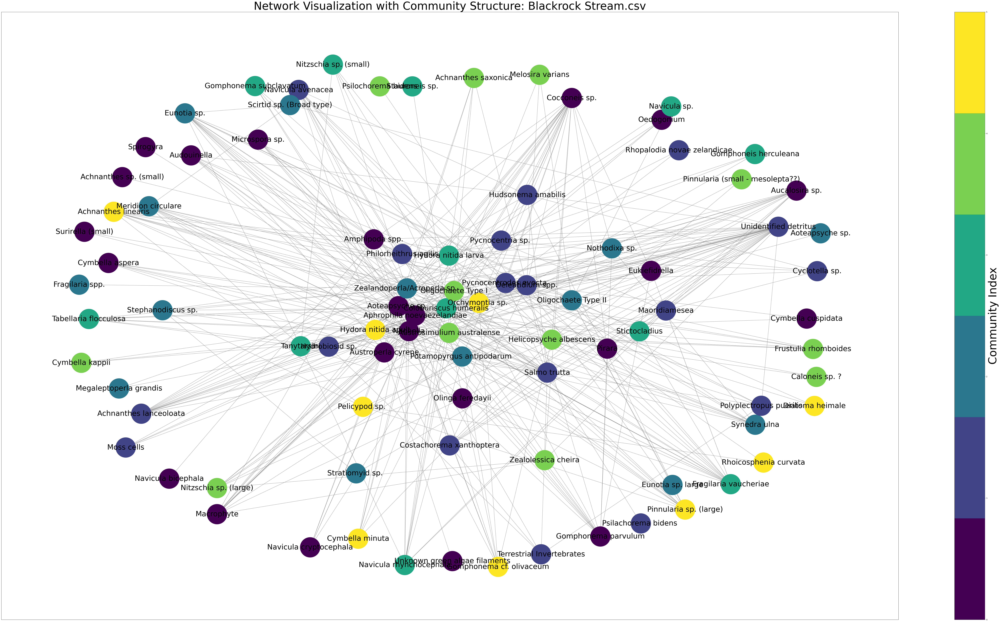

In [44]:
# Detect communities using the greedy modularity algorithm
communities_new = nx.algorithms.community.greedy_modularity_communities(G.to_undirected())

# Assign colors to nodes based on their community
node_colors = {}
for i, community_set in enumerate(communities_new):
    for node in community_set:
        node_colors[node] = i

color_map = [node_colors.get(node, -1) for node in G.nodes()]

# Plot the network
plt.figure(figsize=(110, 60))
pos = nx.spring_layout(G, k=1, seed=42)
nx.draw_networkx(
    G,
    pos=pos,
    with_labels=True,
    node_color=color_map,
    cmap=plt.cm.get_cmap('viridis', len(communities_new)),
    node_size=5000,
    edge_color='gray',
    font_size=40,
    arrows=True,
    font_color='black',
    width=1,
    style='solid',  # Edge style ('solid', 'dashed', 'dotted', etc.)
    alpha=1,  # Transparency level for edges and nodes
    linewidths=40,  # Border width of the nodes
)
plt.title(f"Network Visualization with Community Structure: {file_path.split('/')[-1]}", size=60)

# Normalize color map for colorbar
norm = colors.Normalize(vmin=0, vmax=len(communities_new) - 1)
cbar = plt.colorbar(cm.ScalarMappable(norm=norm, cmap=plt.cm.get_cmap('viridis', len(communities_new))), ax=plt.gca())
cbar.ax.set_ylabel('Community Index', size=60)

plt.show()